# 「中原中也肖像」で機械学習顔分析や美顔処理 -『在りし日』の詩人写真、バズり狙いで美化された説!? - 

In [54]:
import mediapipe as mp;import cv2;import numpy as np;import matplotlib.pyplot as plt

In [65]:
# 記事紹介コードでは使っていない、matplotlibの日本語処理用
import mediapipe as mp;import cv2;import numpy as np;import matplotlib.pyplot as plt
# matplotlibの日本語処理用
#plt.rcParams['font.family']='Hiragino Sans'# フォント設定
#plt.rcParams['font.weight']='bold' # 太さ
plt.rcParams['font.family'] = 'AppleGothic'
plt.rcParams['font.size'] = 20
plt.rcParams["figure.figsize"]=15,15

In [63]:
def eye_center_and_diameter(landmarks, image, image_shape): # 瞳の中心と直径の算出
    coords = np.array([  # Mediapipeのランドマークから瞳の中心と領域を特定
        (int(p.x * image_shape[1]), int(p.y * image_shape[0]))
        for p in landmarks])
    center = np.mean(coords, axis=0).astype(int)    
    eye_size = int(np.max(np.linalg.norm(coords - center, axis=1)) * 2.5)
    x_min = max(center[0] - eye_size, 0)
    x_max = min(center[0] + eye_size, image_shape[1])
    y_min = max(center[1] - eye_size, 0)
    y_max = min(center[1] + eye_size, image_shape[0])
    eye_roi = image[y_min:y_max, x_min:x_max]            # 瞳領域（ROI）を切り出し
    eye_gray = cv2.cvtColor(eye_roi, cv2.COLOR_BGR2GRAY) # グレースケール変換と前処理
    #eye_gray = cv2.GaussianBlur(eye_gray, (5, 5), 0)　　 # 必要に応じてぼかす
    circles = cv2.HoughCircles(                          # Hough円を検出する
        eye_gray, cv2.HOUGH_GRADIENT, dp=1, minDist=20,
        param1=50, param2=30, minRadius=5, maxRadius=eye_size//2)
    if circles is not None: # 円形が検出できたら
        circles = np.round(circles[0, :]).astype(int)
        circle = circles[0] # 最初の円を使用して、円＝瞳中心座標や瞳間距離を算出する
        eye_center = (circle[0]+x_min, circle[1]+y_min); diameter=circle[2]*2
    else: # 円検出失敗時はMediapipeの結果(ランドマークの重心を瞳中心とする)を使う
        print("OpenCVでの円検出ができないため、Mediapipeの結果を使います")
        eye_center=center; diameter=np.max(np.linalg.norm(coords-center,axis=1))*2
    return eye_center, diameter # 左右の瞳中心座標と瞳間距離を返す

def init_mediapipe_face_mesh():# MediaPipeのフェイスメッシュを初期化&顔ランドマーク検出を設定
    mp_face_mesh = mp.solutions.face_mesh # フェイスメッシュモジュールをインポート
    face_mesh = mp_face_mesh.FaceMesh(# FaceMeshオブジェクトを作成
        max_num_faces=1,              # 一度に処理する顔の数を1に制限
        refine_landmarks=True,        # 虹彩追跡のための高精度なランドマーク検出を有効化
        min_detection_confidence=0.5, # 顔検出の最小信頼度閾値を50%に設定
        min_tracking_confidence=0.5)  # 顔追跡の最小信頼度閾値を50%に設定  
    return face_mesh　                # 設定済みのFaceMeshオブジェクトを返す

def show_image(title, image):# 画像を表示
    plt.figure(); plt.title(title) 
    plt.imshow(image, cmap='gray', vmin=0,vmax=255); plt.axis('off'); plt.show()
        
def process_portrait(face_mesh, portrait):
    image = cv2.imread(portrait['path'])  # 画像ファイルを読み込む
    if image is None:
        print("画像の読み込みに失敗しました。"); return None
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # グレー画像に変換する
    multi_face_landmarks = face_mesh.process(image_rgb).multi_face_landmarks
    if multi_face_landmarks and len(multi_face_landmarks[0].landmark) > 477:
        left_center, left_diameter = eye_center_and_diameter( # 左右瞳の中心と直径
            [multi_face_landmarks[0].landmark[i] for i in range(468, 473)],
            image, image.shape)
        right_center, right_diameter = eye_center_and_diameter(
            [multi_face_landmarks[0].landmark[i] for i in range(473, 478)],
            image, image.shape)
        eye_distance=np.linalg.norm(np.array(left_center)-np.array(right_center))#瞳距離
        normalized_left_diameter =100.*left_diameter/eye_distance # 正規化した瞳の大きさ
        normalized_right_diameter=100.*right_diameter/eye_distance# 正規化した瞳の大きさ
        print(f"左の瞳の正規化直径: {normalized_left_diameter:.2f} %")
        print(f"右の瞳の正規化直径: {normalized_right_diameter:.2f} %")
        cv2.circle(image, (int(left_center[0]), int(left_center[1])),  # 向かって左（右目）
                   int(left_diameter / 2), (0, 255, 0), 5)    　　　　　# 緑色の円を描く
        cv2.circle(image, (int(right_center[0]), int(right_center[1])),# 向かって右（左目）
                   int(right_diameter / 2), (0, 255, 0), 5)  　　　　　　# 緑色の円を描く
        show_image(portrait['name'], image)
    else:
        print("瞳領域が検出されませんでした。"); return None
    # 現在は使ってない
    #return (normalized_left_diameter, normalized_right_diameter, # 瞳情報を返す
    #            left_center, left_diameter, right_center, right_diameter,
    #            eye_distance)

## 画像を分析する

I0000 00:00:1749447515.622231   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749447515.628863  402513 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749447515.654706  402516 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


OpenCVでの円検出ができないため、Mediapipeの結果を使います
左の瞳の正規化直径: 17.96 %
右の瞳の正規化直径: 18.05 %


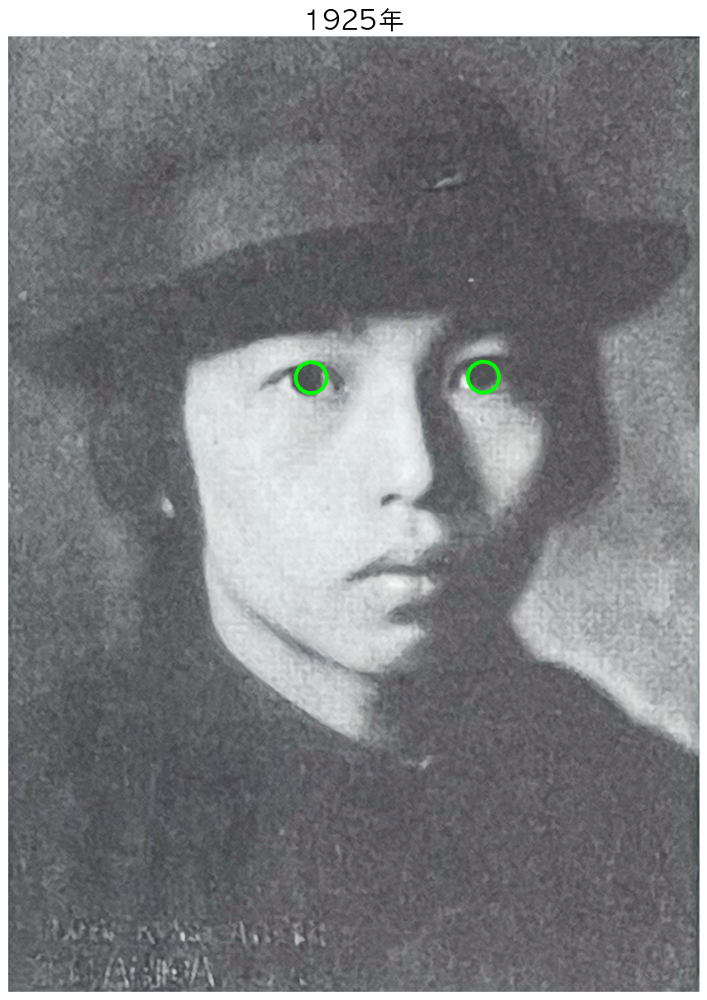

I0000 00:00:1749447516.505428   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749447516.510061  402533 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749447516.532647  402531 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


左の瞳の正規化直径: 20.00 %
右の瞳の正規化直径: 18.06 %


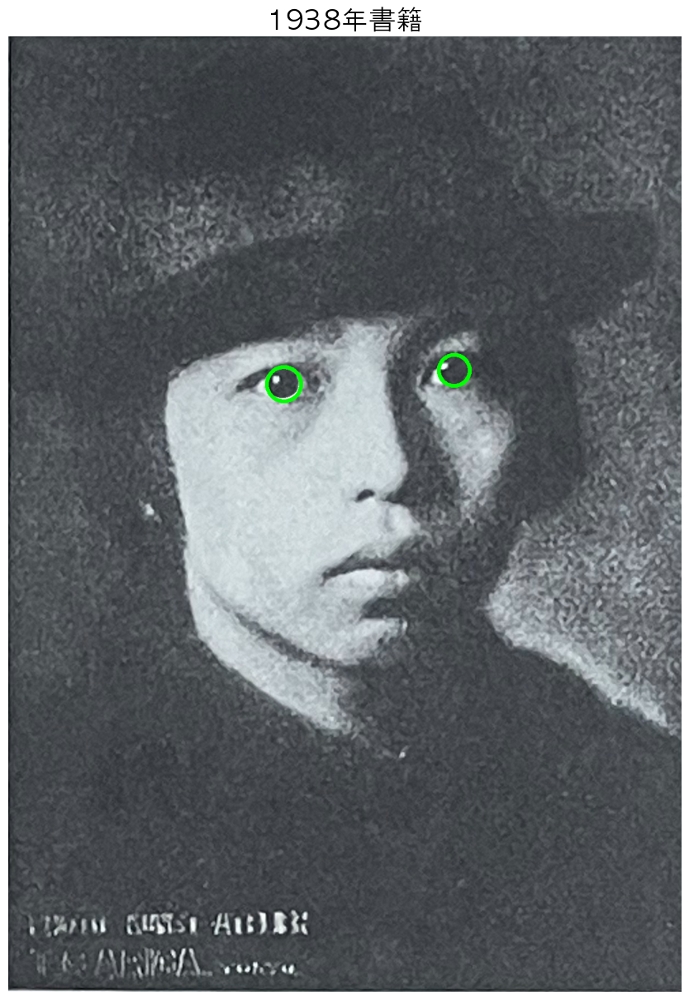

I0000 00:00:1749447517.142679   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749447517.147626  402542 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749447517.168739  402544 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


左の瞳の正規化直径: 15.67 %
右の瞳の正規化直径: 19.20 %


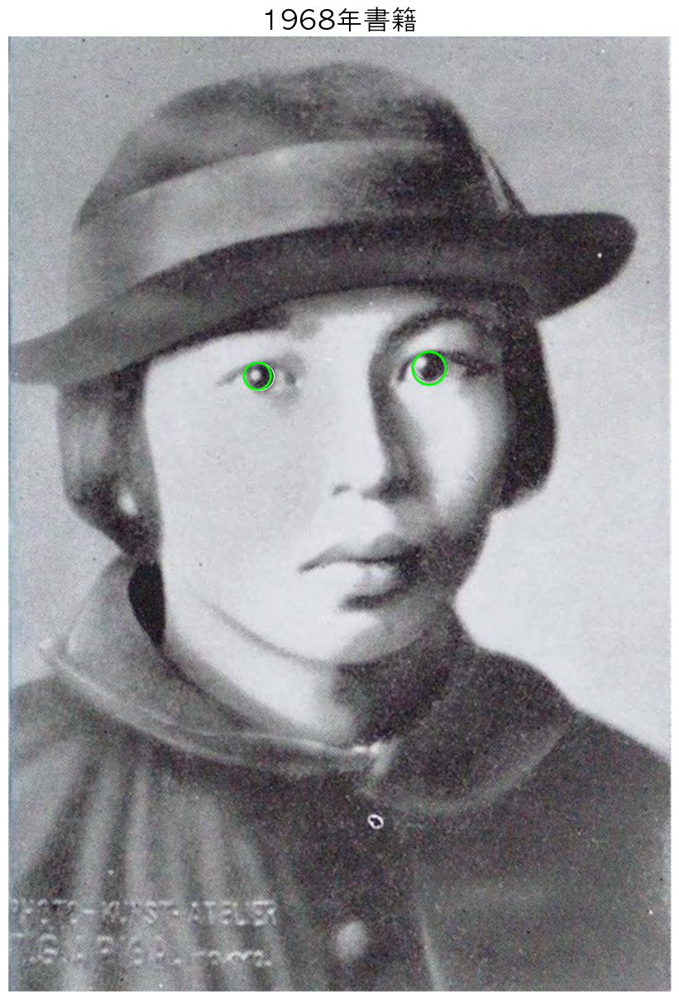

I0000 00:00:1749447518.196336   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749447518.202933  402556 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749447518.223724  402563 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


左の瞳の正規化直径: 22.37 %
右の瞳の正規化直径: 20.06 %


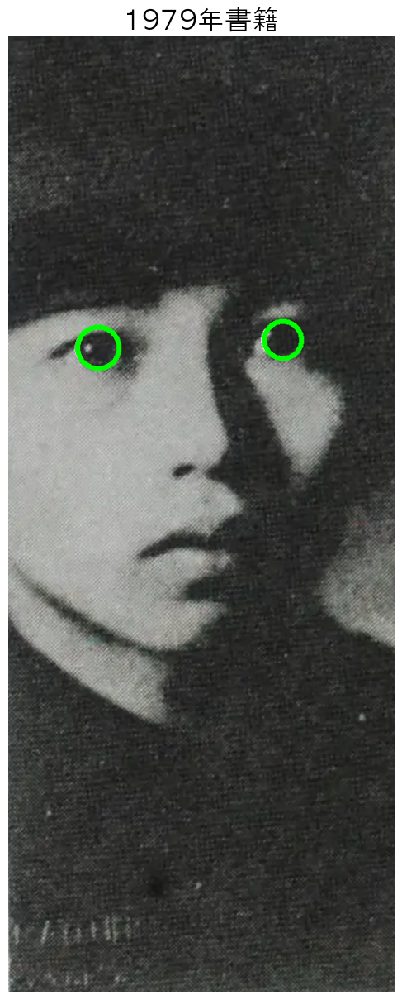

I0000 00:00:1749447518.652166   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749447518.657925  402565 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749447518.676474  402570 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


OpenCVでの円検出ができないため、Mediapipeの結果を使います
OpenCVでの円検出ができないため、Mediapipeの結果を使います
左の瞳の正規化直径: 20.06 %
右の瞳の正規化直径: 18.07 %


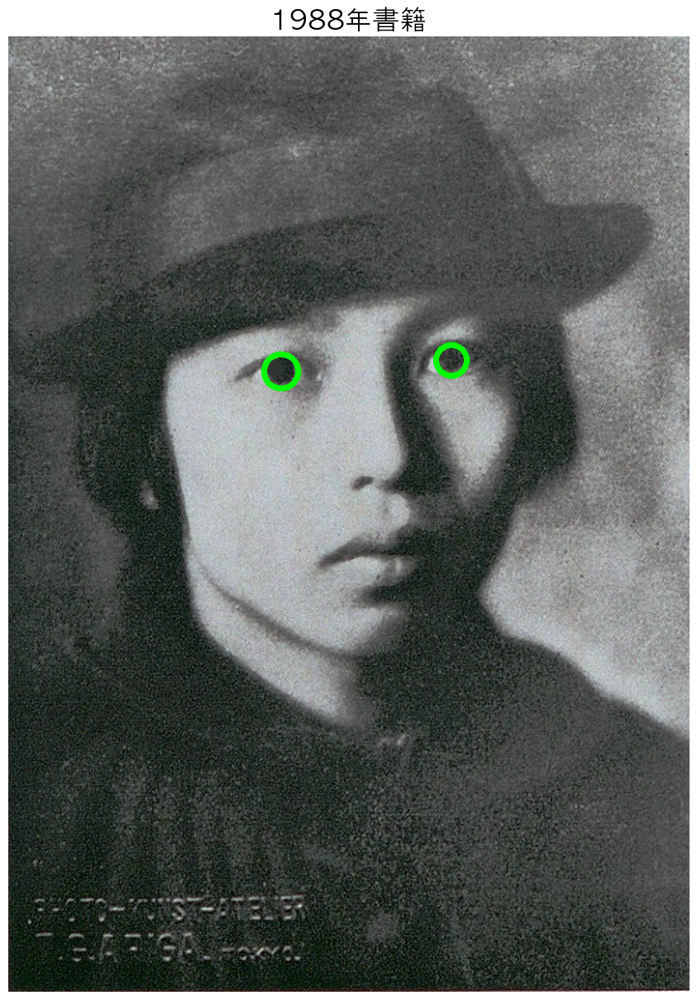

In [85]:
portraits=[{'name':'1925年','path':'1925.png'},
    {'name':'1938年書籍','path':'1938.png'},{'name':'1968年書籍','path':'1968.png'},
    {'name':'1979年書籍','path':'1979.png'},{'name':'1988年書籍','path':'1988.png'},]
for portrait in portraits:
    face_mesh=init_mediapipe_face_mesh(); process_portrait(face_mesh, portrait)
    face_mesh.close()

I0000 00:00:1749443762.368660   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749443762.377811  359319 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749443762.401048  359316 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


OpenCVでの円検出ができないため、Mediapipeの結果を使います
OpenCVでの円検出ができないため、Mediapipeの結果を使います
左の瞳の正規化直径: 20.09 %
右の瞳の正規化直径: 18.93 %


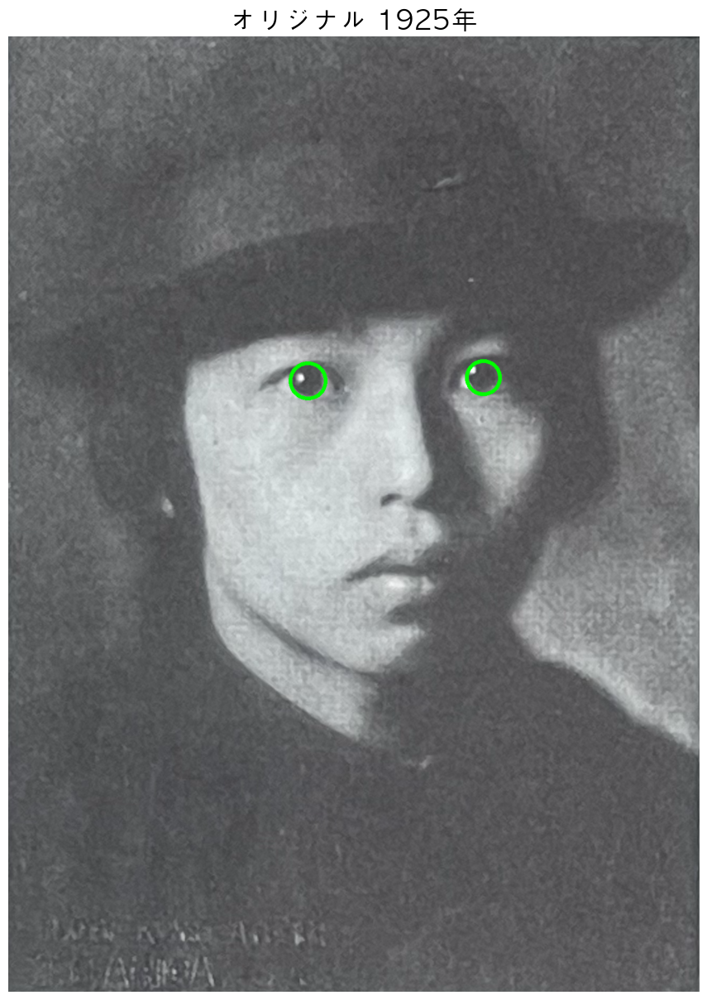

I0000 00:00:1749443763.004796   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749443763.010385  359337 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749443763.028116  359335 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


左の瞳の正規化直径: 20.00 %
右の瞳の正規化直径: 18.06 %


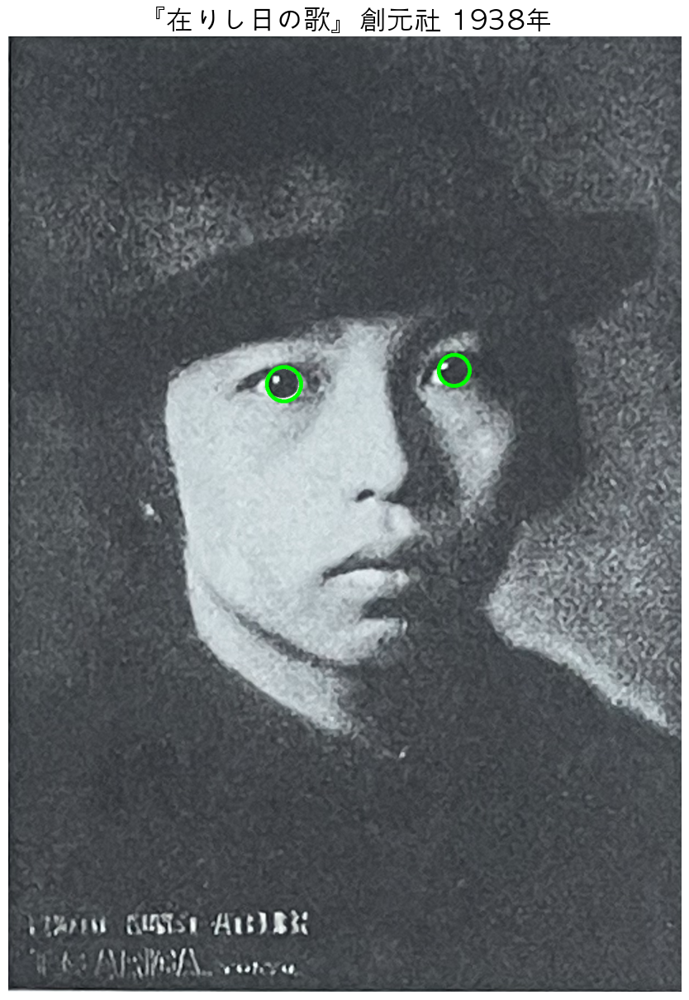

I0000 00:00:1749443763.638731   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749443763.644576  359348 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749443763.670640  359351 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


左の瞳の正規化直径: 15.67 %
右の瞳の正規化直径: 19.20 %


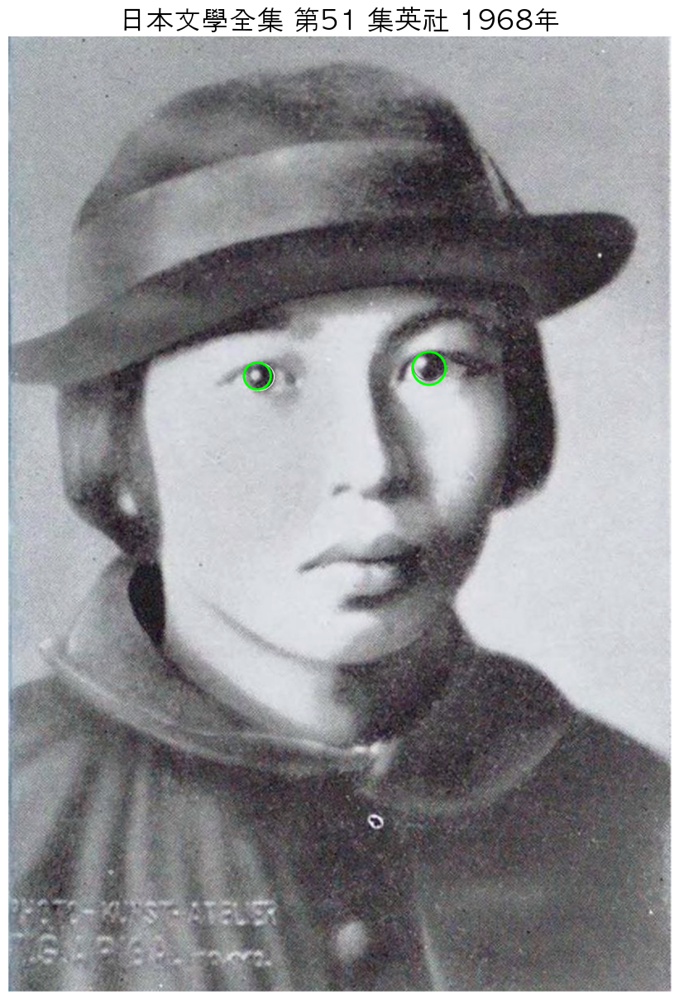

I0000 00:00:1749443764.746398   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749443764.751812  359398 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749443764.770113  359397 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


左の瞳の正規化直径: 22.37 %
右の瞳の正規化直径: 20.06 %


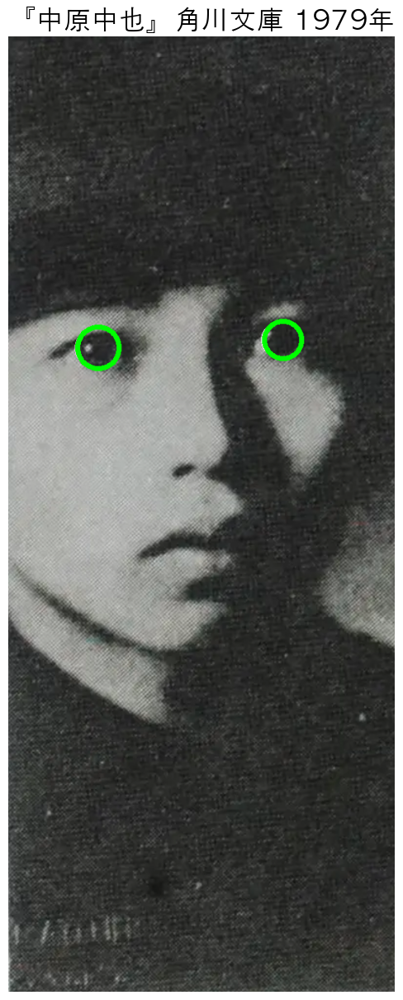

I0000 00:00:1749443765.254334   16755 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1749443765.261752  359418 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1749443765.283213  359415 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


OpenCVでの円検出ができないため、Mediapipeの結果を使います
OpenCVでの円検出ができないため、Mediapipeの結果を使います
左の瞳の正規化直径: 20.06 %
右の瞳の正規化直径: 18.07 %


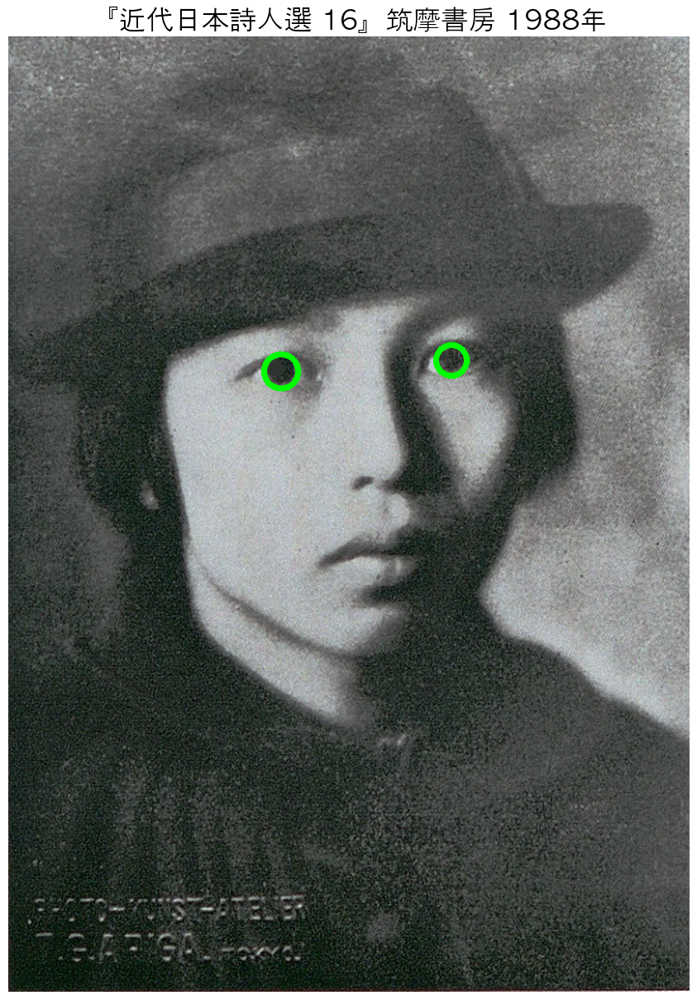

In [77]:
portraits=[{'name':'オリジナル 1925年','path':'00_original_print.png'},
           {'name':'『在りし日の歌』創元社 1938年','path':'01_1938_arishi_.png'},
           {'name':'日本文學全集 第51 集英社 1968年','path':'03_1968_zensyu_.png'},
           {'name':'『中原中也』角川文庫 1979年','path':'04_1979_nakahara_chuya_.png'},
           {'name':'『近代日本詩人選 16』筑摩書房 1988年','path':'06_1988_kindai_.png'},]
for portrait in portraits:
    face_mesh = init_mediapipe_face_mesh()
    process_portrait(face_mesh, portrait)
    face_mesh.close()

## 画像強調や弱化をする

In [ ]:
import cv2; import numpy as np

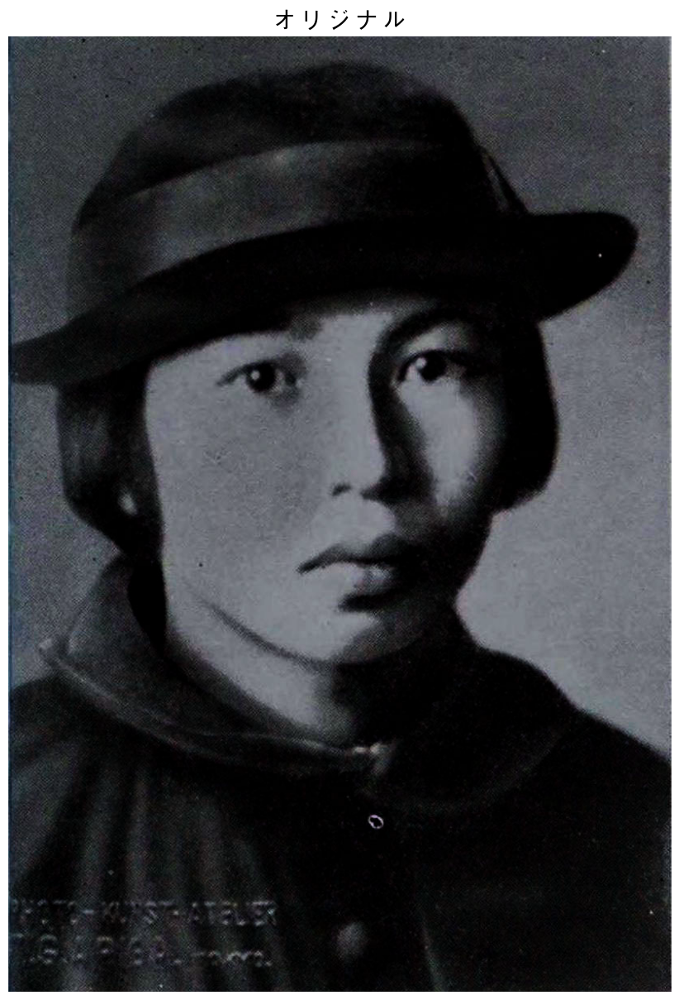

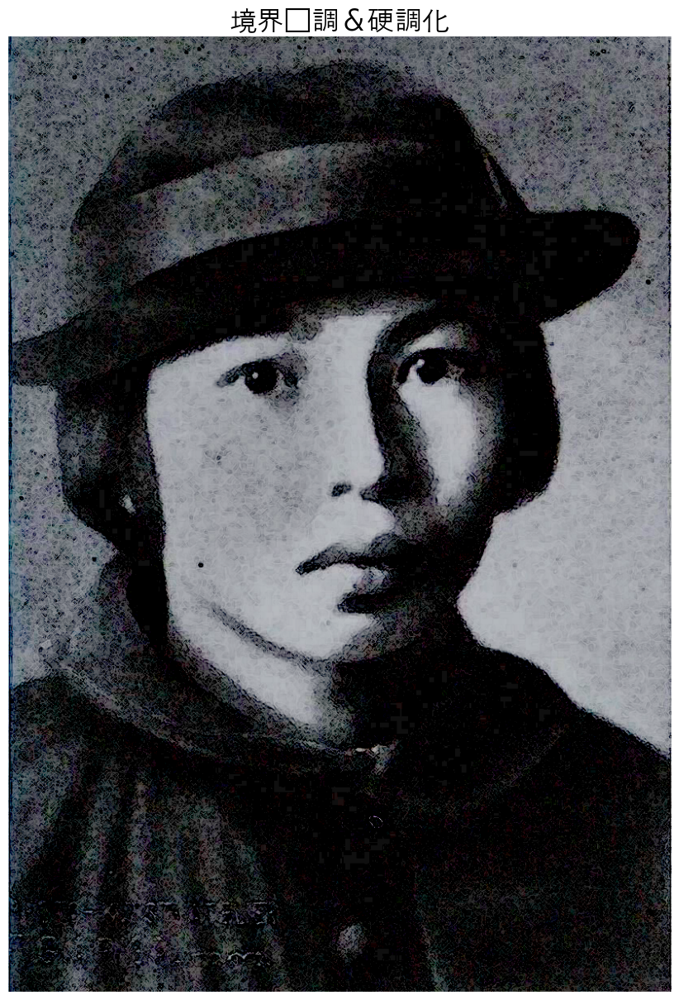

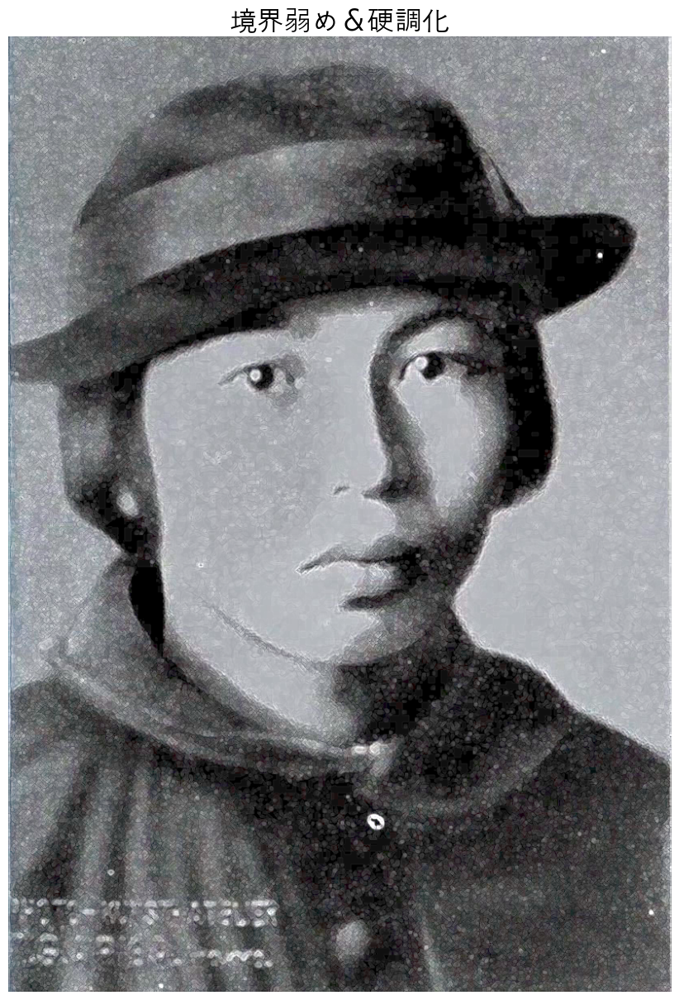

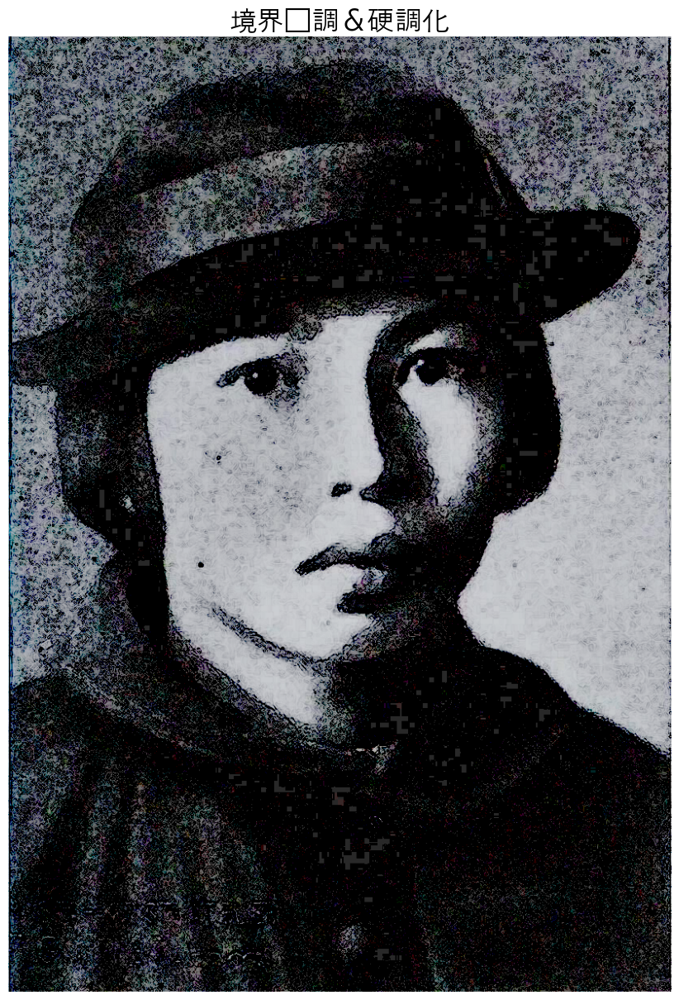

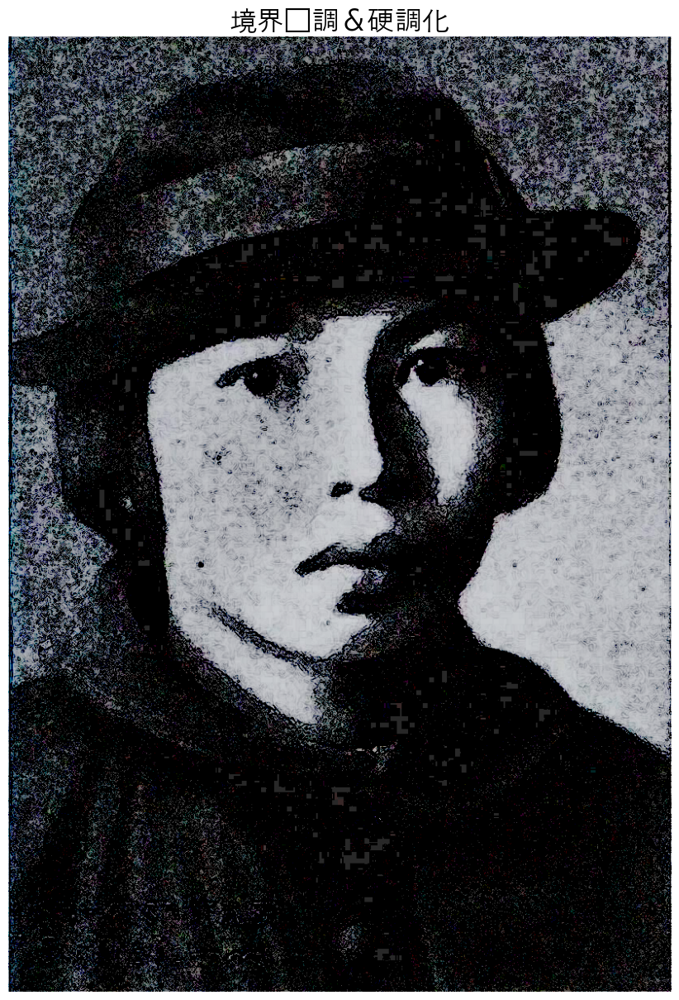

In [89]:
def compute_abs_gradient_sum(gray): # 画像の輪郭強度を計算
    grad_x = cv2.Sobel(gray, cv2.CV_32F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(gray, cv2.CV_32F, 0, 1, ksize=3)
    return np.abs(grad_x) + np.abs(grad_y)

def gamma_correction(image, gamma=1.0): # 階調（ガンマ）変換
    table=np.array([((i/255.0)**(1.0/gamma))*255 for i in \
                    np.arange(0, 256)]).astype(np.uint8)
    return cv2.LUT(image, table)

# image: 入力画像、alpha: 正なら強調、負なら弱調（スムージング効果）,gamma:階調ガンマ
def process_image_gradient(image, alpha=0.5, gamma=1.0): 
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)   # グレースケール変換
    gradient = compute_abs_gradient_sum(gray)        # 画像全体のグラジエント（輪郭強度）を計算
    gradient_norm = cv2.normalize(gradient, None, 0, 255, cv2.NORM_MINMAX)
    adjustment = (alpha * gradient_norm)[..., None]  # RGBの3次元に変換する
    result = np.clip(image.astype(np.float32) + adjustment, 0, 255).astype(np.uint8)
    return gamma_correction(result, gamma)

image = cv2.imread("portrait.jpg"); show_image("オリジナル", image)
show_image("境界強調＆硬調化", process_image_gradient(image, alpha=-1.5, gamma=2.0))
show_image("境界弱め＆硬調化", process_image_gradient(image, alpha=1.5, gamma=2.0))

show_image("境界強調＆硬調化", process_image_gradient(image, alpha=-2.5, gamma=3.0))
show_image("境界強調＆硬調化", process_image_gradient(image, alpha=-3.5, gamma=3.0))



## 以下は、記事では採用しなかったコード例

I0000 00:00:1750110312.530898   87326 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
INFO: Created TensorFlow Lite XNNPACK delegate for CPU.
W0000 00:00:1750110312.591329   99490 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1750110312.626689   99490 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1750110312.695160   99487 landmark_projection_calculator.cc:186] Using NORM_RECT without IMAGE_DIMENSIONS is only supported for the square ROI. Provide IMAGE_DIMENSIONS or use PROJECTION_MATRIX.


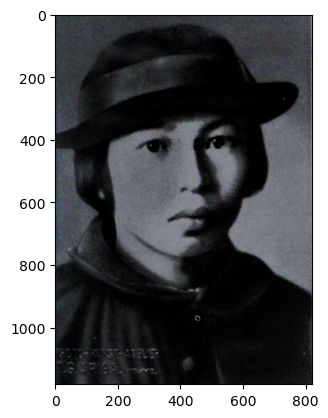

In [1]:
import mediapipe as mp
import cv2
import numpy as np

def compute_abs_gradient_sum(gray):
    grad_x = cv2.Sobel(gray, cv2.CV_32F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(gray, cv2.CV_32F, 0, 1, ksize=3)
    abs_grad = np.abs(grad_x) + np.abs(grad_y)
    return abs_grad

def process_eye(image, landmarks, eye_name, alpha, mode='gradient'):
    coords = np.array([(int(p.x * image.shape[1]), int(p.y * image.shape[0])) for p in landmarks])
    center_x, center_y = np.mean(coords, axis=0).astype(int)

    if mode == 'scale':
        radius = int(np.max(np.linalg.norm(coords - np.array([center_x, center_y]), axis=1)) * 1.5)
        radius = max(10, radius)
        diameter = 2 * radius

        mask = np.zeros(image.shape[:2], dtype=np.uint8)
        cv2.circle(mask, (center_x, center_y), radius, 255, -1)
        mask = cv2.GaussianBlur(mask, (9, 9), 0)

        x = max(0, center_x - radius)
        y = max(0, center_y - radius)
        w = min(image.shape[1] - x, 2 * radius)
        h = min(image.shape[0] - y, 2 * radius)

        eye_patch = image[y:y+h, x:x+w]
        patch_mask = mask[y:y+h, x:x+w]

        scale_factor = 1.0 + alpha if alpha > 0 else 1.0 - abs(alpha)
        new_size = (
            max(1, int(w * scale_factor)),
            max(1, int(h * scale_factor))
        )

        x_offset = max(0, center_x - new_size[0] // 2)
        y_offset = max(0, center_y - new_size[1] // 2)
        x_end = min(image.shape[1], x_offset + new_size[0])
        y_end = min(image.shape[0], y_offset + new_size[1])
        new_size_clipped = (x_end - x_offset, y_end - y_offset)

        if new_size_clipped[0] <= 0 or new_size_clipped[1] <= 0:
            print(f"{eye_name}: クリッピング後のサイズが無効です（{new_size_clipped}）。")
            return image

        scaled_eye = cv2.resize(eye_patch, new_size_clipped, interpolation=cv2.INTER_CUBIC)
        scaled_mask = cv2.resize(patch_mask, new_size_clipped, interpolation=cv2.INTER_AREA)
        scaled_mask = cv2.GaussianBlur(scaled_mask, (9, 9), 0)

        scaled_mask_full = np.zeros(image.shape[:2], dtype=np.uint8)
        paste_h, paste_w = scaled_mask.shape[:2]
        scaled_mask_full[y_offset:y_offset+paste_h, x_offset:x_offset+paste_w] = scaled_mask

        result = image.copy()
        try:
            alpha_layer = np.clip(scaled_mask[..., None] / 255.0 * 1.2, 0, 1)
            result[y_offset:y_offset+paste_h, x_offset:x_offset+paste_w] = (
                alpha_layer * scaled_eye + (1 - alpha_layer) * result[y_offset:y_offset+paste_h, x_offset:x_offset+paste_w]
            ).astype(np.uint8)
        except ValueError as e:
            print(f"{eye_name}のアルファブレンディングエラー: {e}")
            return image
        return result

    if mode == 'gradient':
        hull = cv2.convexHull(coords)
        mask = np.zeros(image.shape[:2], dtype=np.uint8)
        cv2.fillConvexPoly(mask, hull, 255)
        mask = cv2.GaussianBlur(mask, (9, 9), 0)
        x, y, w, h = cv2.boundingRect(hull)
        if w == 0 or h == 0:
            print(f"{eye_name}: 無効なサイズです。スキップします。")
            return image
        roi = image[y:y+h, x:x+w]
        roi_mask = mask[y:y+h, x:x+w]

        gray_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
        gradient = compute_abs_gradient_sum(gray_roi)
        gradient_norm = cv2.normalize(gradient, None, 0, 255, cv2.NORM_MINMAX)

        adjustment = (abs(alpha) * gradient_norm)[..., None]
        modified_roi = np.clip(
            roi.astype(np.float32) + np.sign(alpha) * adjustment,
            0, 255
        ).astype(np.uint8)
        result = image.copy()
        alpha_mask = roi_mask[..., None] / 255.0
        result[y:y+h, x:x+w] = (
            alpha_mask * modified_roi + (1 - alpha_mask) * roi
        ).astype(np.uint8)
        return result

# 使用例（瞳処理）

if __name__ == '__main__':
    import matplotlib.pyplot as plt
    mp_face_mesh = mp.solutions.face_mesh
    face_mesh = mp_face_mesh.FaceMesh(
        max_num_faces=1,
        refine_landmarks=True,
        min_detection_confidence=0.5,
        min_tracking_confidence=0.5
    )

    image = cv2.imread('portrait.jpg')
    if image is None:
        print("画像の読み込みに失敗しました。")
        exit()

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = face_mesh.process(image_rgb)

    if results.multi_face_landmarks:
        for face_landmarks in results.multi_face_landmarks:
            if len(face_landmarks.landmark) > 477:
                result = image.copy()
                right_eye = [face_landmarks.landmark[i] for i in range(473, 478)]
                left_eye  = [face_landmarks.landmark[i] for i in range(468, 473)]

                #result = process_eye(result, right_eye, "right_eye", 
                #                     alpha= 0.5, mode='scale')
                #result = process_eye(result, left_eye,  "left_eye",  
                #                     alpha= 0.5, mode='scale')
                result = process_eye(result, right_eye + left_eye, "eyes", 
                                     alpha=-0.8, mode='gradient')

                #cv2.imwrite('unified_result.jpg', result)
                #print("処理済み画像を'simplified_result.jpg'に保存しました。")
                plt.imshow(result)
                plt.show()
    else:
        print("顔が検出されませんでした。")
    face_mesh.close()

I0000 00:00:1750110447.570358   87326 gl_context.cc:369] GL version: 2.1 (2.1 NVIDIA-16.0.12 355.11.11.10.10.143), renderer: NVIDIA GeForce GT 750M OpenGL Engine
W0000 00:00:1750110447.577564  101508 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1750110447.633793  101507 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


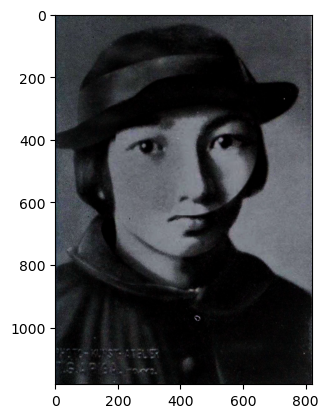

In [6]:
if __name__ == '__main__':
    import matplotlib.pyplot as plt
    mp_face_mesh = mp.solutions.face_mesh
    face_mesh = mp_face_mesh.FaceMesh(
        max_num_faces=1,
        refine_landmarks=True,
        min_detection_confidence=0.5,
        min_tracking_confidence=0.5
    )

    image = cv2.imread('portrait.jpg')
    if image is None:
        print("画像の読み込みに失敗しました。")
        exit()

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = face_mesh.process(image_rgb)

    if results.multi_face_landmarks:
        for face_landmarks in results.multi_face_landmarks:
            if len(face_landmarks.landmark) > 477:
                result = image.copy()
                right_eye = [face_landmarks.landmark[i] for i in range(473, 478)]
                left_eye  = [face_landmarks.landmark[i] for i in range(468, 473)]

                #result = process_eye(result, right_eye, "right_eye", 
                #                     alpha= 0.5, mode='scale')
                #result = process_eye(result, left_eye,  "left_eye",  
                #                     alpha= 0.5, mode='scale')
                result = process_eye(result, right_eye + left_eye, "eyes", 
                                     alpha=+0.2, mode='scale')

                #cv2.imwrite('unified_result.jpg', result)
                #print("処理済み画像を'simplified_result.jpg'に保存しました。")
                plt.imshow(result)
                plt.show()
    else:
        print("顔が検出されませんでした。")

    face_mesh.close()